In [167]:
# plot horiontal vector fields
import numpy as np
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import loadData as ld
import matplotlib.pyplot as plt
import plotly.figure_factory as ff

init_notebook_mode(connected=True)
from plotly import __version__
print('plotly version: ', __version__) 
from IPython.display import HTML

plotly version:  2.7.0


In [168]:
HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
The raw code for this IPython notebook is by default hidden for easier reading.
To toggle on/off the raw code, click <a href="javascript:code_toggle()">here</a>.''')


In [169]:
base_dir = "/home/ahsan/4rows_angle_45"
inparam = ld.readInput(base_dir+"/input/LESinputs.txt");
file_path = base_dir+"/input/u.ini"
u = np.fromfile(file_path, dtype=np.float64);
u = np.reshape(u, [ inparam['Nx'], inparam['Ny'], inparam['Nz'] ], order='F');
file_path = base_dir+"/input/v.ini"
v = np.fromfile(file_path, dtype=np.float64);
v = np.reshape(v, [ inparam['Nx'], inparam['Ny'], inparam['Nz'] ], order='F');
file_path = base_dir+"/input/PlantDensity.ini"
plantd = np.fromfile(file_path, dtype=np.float64);
plantd = np.reshape(plantd, [ inparam['Nx'], inparam['Ny'], inparam['Nz'] ], order='F');


XX = np.zeros([ inparam['Nx'], inparam['Ny'], inparam['Nz'] ])
YY = np.zeros([ inparam['Nx'], inparam['Ny'], inparam['Nz'] ])
ZZ = np.zeros([ inparam['Nx'], inparam['Ny'], inparam['Nz'] ])

for zidx in np.arange(0, inparam['Nz']):
    z_cord = np.ones([inparam['Nx'], inparam['Ny'] ])
    [x_cord, y_cord] = np.meshgrid(np.arange(0, inparam['Nx']), np.arange(0, inparam['Ny']))
    XX[:,:,zidx] = x_cord.T;
    YY[:,:,zidx] = y_cord.T;
    ZZ[:,:,zidx] = zidx * z_cord; 



In [170]:
print("Nx: {0:2.1f}  Ny: {1:2.1f}  Nz: {2:2.1f}  ".format(inparam['Nx'],inparam['Ny'],inparam['Nz']))

Nx: 48.0  Ny: 48.0  Nz: 96.0  


In [171]:
zmax = 30
densVal=np.reshape(plantd[:,:,zmax ], inparam['Nx']*inparam['Ny']*1, order='F'),

data_series = [dict(      
                    go.Scatter3d(
                            x=np.reshape(XX[:,:,step], inparam['Nx']*inparam['Ny']*1, order='F'),
                            y=np.reshape(YY[:,:,step], inparam['Nx']*inparam['Ny']*1, order='F'),
                            z=np.reshape(ZZ[:,:,step], inparam['Nx']*inparam['Ny']*1, order='F'),
                            mode='markers',
                            marker=dict(
                                size=6,
                                color=np.reshape(plantd[:,:,step], inparam['Nx']*inparam['Ny']*1, order='F'), 
                                colorscale='Viridis',   # choose a colorscale
                                opacity=0.5,            
                                colorbar=dict(
                                    title='Colorbar'
                                ),
                            )

                        ),
                        visible = False,
                    ) for step in np.arange(inparam['Nz'])]
data_series[10]['visible'] = True
#print(data_series)

steps = []
for i in range(inparam['Nz']):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * inparam['Nz']],
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible"
    #step['args'][1][0] = True # Toggle 0'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active = 10,
    steps = steps
)]

layout = dict(sliders=sliders)

fig = dict(data=data_series, layout=layout)
iplot(fig, show_link=False)

In [172]:
densVal=np.reshape(plantd[:,:,90], inparam['Nx']*inparam['Ny']*1, order='F')
print(np.max(densVal))

0.0


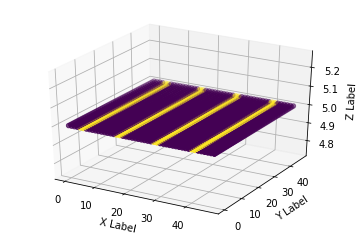

In [173]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

step = 5
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
x=np.reshape(XX[:,:,step], inparam['Nx']*inparam['Ny']*1, order='F')
y=np.reshape(YY[:,:,step], inparam['Nx']*inparam['Ny']*1, order='F')
z=np.reshape(ZZ[:,:,step], inparam['Nx']*inparam['Ny']*1, order='F')
c = np.reshape(plantd[:,:,5], inparam['Nx']*inparam['Ny']*1, order='F')
ax.scatter(x, y, z, c=c, marker='o')

ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

plt.show()

In [3]:
x,y = np.meshgrid(np.arange(inparam['Nx']),
                  np.arange(inparam['Ny']))
z = x*np.exp(-x**2 - y**2)
v, u = np.gradient(z, .2, .2)

# Create quiver figure

dummyfig = [ dict(ff.create_quiver(x, y, u*np.random.random(x.shape), v,
                       scale=.25,
                       arrow_scale=.4,
                       name='quiver',
                       line=dict(width=1))['data'][0]) for step in np.arange(inparam['Nz'])]
#print(data_series_1)

steps = []
for i in range(inparam['Nz']):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * inparam['Nz']],
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible"
    #step['args'][1][0] = True # Toggle 0'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active = 10,
    currentvalue = {"prefix": "Z index: "},
    steps = steps
)]

layout = dict(sliders=sliders)

fig = dict(data=dummyfig, layout=layout)
iplot(fig, show_link=False);print('ustar_0_max: ', ustar_0_max);

NameError: name 'np' is not defined

In [ ]:
selects = np.array([24]);
x,y = np.meshgrid(np.arange(inpara_0['Nx']),
                  np.arange(inpara_0['Nz']));

for i in np.arange(inpara_0['Nx']):
    x[:,i] = x[:,i]*inpara_0['dx']
    
for i in np.arange(inpara_0['Nx']):
    y[:,i] = y[:,i]*inpara_0['dz']

# Create quiver figure
pevery = 2;
dummyfig = [ dict(ff.create_quiver(x[::pevery,::pevery], y[::pevery, ::pevery],\
                       uu_0[::pevery,step,::pevery].T, ww_0[::pevery,step,::pevery].T,
                       scale= 4,
                       arrow_scale=0.4,
                       name='quiver',
                       line=dict(width=1))['data'][0]) for step in selects];
#print(data_series_1)

steps = [];
for i in np.arange(selects.shape[0]):
    step = dict(
        method = 'restyle',
        args = ['visible', [False] * selects.shape[0]],
    )
    step['args'][1][i] = True # Toggle i'th trace to "visible"
    #step['args'][1][0] = True # Toggle 0'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active = 10,
    currentvalue = {"prefix": "x_2 index: "},
    steps = steps
)]

layout = dict(sliders=sliders)

fig = dict(data=dummyfig, layout=layout)
iplot(fig, show_link=False);